<a href="https://colab.research.google.com/github/guillermoverhelst/BotElied/blob/main/Enfasis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install folium


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/



# **PASO 1**

In [ ]:
import pandas as pd
import numpy as np
import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
df = pd.read_csv('/content/dataset (1).csv')
df.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,duration_sec
0,D3D7103338624F7F,electric_bike,2022-11-12 17:23:42,2022-11-12 17:30:15,5 Corners Library,JC018,Jersey & 3rd,JC074,40.734961,-74.059503,40.723332,-74.045953,member,393.0
1,1F2F367DDE2B8944,classic_bike,2022-11-24 16:00:48,2022-11-24 16:05:57,5 Corners Library,JC018,Jersey & 3rd,JC074,40.735147,-74.059547,40.723332,-74.045953,member,309.0
2,5E4D983010F285A6,classic_bike,2022-11-19 17:45:32,2022-11-19 17:52:30,Christ Hospital,JC034,McGinley Square,JC055,40.734794,-74.050345,40.725340,-74.067622,member,418.0
3,85BC902CD96CF943,classic_bike,2022-11-07 16:09:09,2022-11-07 16:14:54,JC Medical Center,JC110,Jersey & 3rd,JC074,40.715391,-74.049692,40.723332,-74.045953,member,345.0
4,460571B25EEEBBFF,classic_bike,2022-11-21 09:22:39,2022-11-21 09:29:39,JC Medical Center,JC110,McGinley Square,JC055,40.715494,-74.049660,40.725340,-74.067622,member,420.0


# **PASO 3**

In [ ]:
#PASO 3
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1768 entries, 0 to 1767
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ride_id             1768 non-null   object 
 1   rideable_type       1768 non-null   object 
 2   started_at          1768 non-null   object 
 3   ended_at            1768 non-null   object 
 4   start_station_name  1768 non-null   object 
 5   start_station_id    1768 non-null   object 
 6   end_station_name    1768 non-null   object 
 7   end_station_id      1768 non-null   object 
 8   start_lat           1768 non-null   float64
 9   start_lng           1768 non-null   float64
 10  end_lat             1768 non-null   float64
 11  end_lng             1768 non-null   float64
 12  member_casual       1768 non-null   object 
 13  duration_sec        1768 non-null   float64
dtypes: float64(5), object(9)
memory usage: 193.5+ KB


,start_lat,start_lng,end_lat,end_lng,duration_sec
count,1768.000000,1768.000000,1768.000000,1768.000000,1768.000000
mean,40.727961,-74.046908,40.730225,-74.040774,625.324661
std,0.010692,0.014504,0.013352,0.008361,441.226446
min,40.711242,-74.067622,40.709056,-74.067622,300.000000
25%,40.719417,-74.062859,40.719586,-74.043117,380.000000
50%,40.725685,-74.046549,40.723659,-74.041664,491.000000
75%,40.736068,-74.030377,40.742659,-74.033541,674.000000
max,40.754157,-74.024055,40.754090,-74.010434,4524.000000


# **PASO 4**

<ipython-input-6-9214c1554d5c>:3: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  idxRowNan = pd.isnull(df).any(1).to_numpy().nonzero()


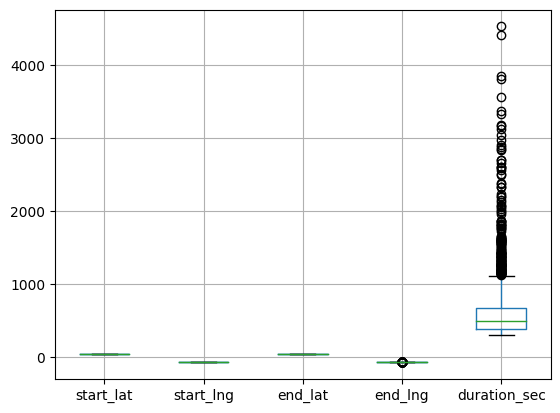

In [ ]:
#PASO 4
#DATOS FALTANTES
idxRowNan = pd.isnull(df).any(1).to_numpy().nonzero()
#print(df.iloc[idxRowNan])
#DATOS ATIPICOS
#df.boxplot(figsize=(20,400))
#plt.show()
#media_tripduration = df['tripduration'].mean()
''' desv_tripduration = df['tripduration'].std()
limite_superior = media_tripduration + 2 * desv_tripduration
limite_inferior = media_tripduration - 2 * desv_tripduration
tripduration_atipicos = [trip for trip in df['tripduration'] if trip > limite_superior or trip < limite_inferior]
#print(tripduration_atipicos)
#DATOS DUPLICADOS
df_duplicates = df[df.duplicated(subset=['starttime','stoptime','bikeid'],keep=False)]
#print(df_duplicates) '''
df.boxplot()
plt.show()

# **PASO 5**

In [ ]:
#Descripcion todos los datos del dataframe
#df.describe()
#Calculo de medidas de tendencia central y dispercion
#moda_tripduration = df['tripduration'].median()
#media_tripduration = df['tripduration'].mean()
#desv_tripduration = df['tripduration'].std()
#print("Media de la duración del viaje:", media_tripduration)
#print("Mediana de la duración del viaje:", moda_tripduration)
#print("Desviación estándar de la duración del viaje:", desv_tripduration)

#Calculo de la frecuencia de las estaciones de inicio y fin
#estacion_inicio = df['start station name'].value_counts()
#estacion_fin = df['end station name'].value_counts()
#print(estacion_inicio.head())
#print(estacion_fin.head())
matriz_correlacion = df.corr()
print(matriz_correlacion)

              start_lat  start_lng   end_lat   end_lng  duration_sec
start_lat      1.000000   0.702926  0.643319  0.389308      0.001912
start_lng      0.702926   1.000000  0.659744  0.421976      0.044935
end_lat        0.643319   0.659744  1.000000  0.470149      0.031552
end_lng        0.389308   0.421976  0.470149  1.000000      0.032971
duration_sec   0.001912   0.044935  0.031552  0.032971      1.000000


<ipython-input-11-64fb98e1525b>:16: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  matriz_correlacion = df.corr()


<function matplotlib.pyplot.show(close=None, block=None)>

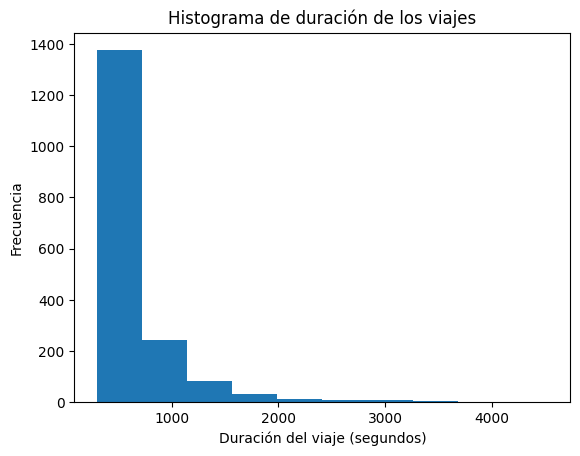

In [ ]:
#Viajes con una duracion menor a 10000
df_trp_menor_10000 = df[df['duration_sec'] <= 10000]
plt.hist(df_trp_menor_10000['duration_sec'])
plt.xlabel('Duración del viaje (segundos)')
plt.ylabel('Frecuencia')
plt.title('Histograma de duración de los viajes')
plt.show


<function matplotlib.pyplot.show(close=None, block=None)>

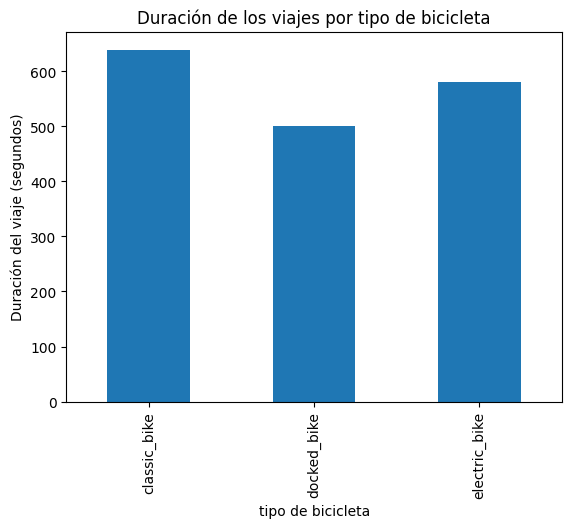

In [ ]:
df_trp_menor_10000 = df[df['duration_sec'] <= 10000]
df_agrupado_media = df_trp_menor_10000.groupby('rideable_type')['duration_sec'].mean()
df_agrupado_media = df_agrupado_media.rename(index={0:'Desconocido',1:'Hombre',2:'Mujer'})
df_agrupado_media.plot(kind='bar')
plt.xlabel('tipo de bicicleta')
plt.ylabel('Duración del viaje (segundos)')
plt.title('Duración de los viajes por tipo de bicicleta')
plt.show

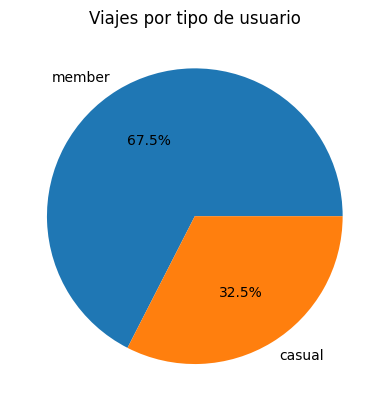

In [ ]:
tipos_usuario = df_trp_menor_10000['member_casual'].value_counts()
plt.pie(tipos_usuario,labels=tipos_usuario.index,autopct='%1.1f%%')
plt.title('Viajes por tipo de usuario')
plt.show()

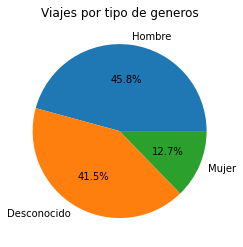

In [ ]:
generos = df_trp_menor_10000['gender'].replace({0:'Desconocido',1:'Hombre',2:'Mujer'}).value_counts()
plt.pie(generos,labels=generos.index,autopct='%1.1f%%')
plt.title('Viajes por tipo de generos')
plt.show()

In [ ]:
new_york = folium.Map(location=[40.78343, -73.96625],zoom_start=11)
datos = [(lat, lon) for lat,lon in zip(df["start station latitude"], df['start station longitude'])]
HeatMap(datos).add_to(new_york)
new_york

In [ ]:
new_york = folium.Map(location=[40.78343, -73.96625],zoom_start=11)
#como hay personas que no terminan el viaje toca eliminar el Nan de las variables
df_sin_Nan = df.dropna(subset=['end station latitude','end station longitude'])
datos = [(lat, lon) for lat,lon in zip(df_sin_Nan["end station latitude"], df_sin_Nan['end station longitude'])]
HeatMap(datos).add_to(new_york)
new_york